<a href="https://colab.research.google.com/github/pannavich/2143488_Big_Data_and_AI/blob/main/BigData_Project_CryptoPricePrediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install cryptocmd

     |████████████████████████████████| 47 kB 4.8 MB/s 


In [5]:
import numpy as np
import pandas as pd
import random
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Bidirectional
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from collections import deque
import matplotlib.pyplot as plt

In [64]:
np.random.seed(314)
tf.random.set_seed(314)
random.seed(314)

Import data from www.coinmarketcap.com through CmcScraper library


In [15]:
from cryptocmd import CmcScraper

# scraper for 1 year
def getHistoricalData(name):
  scraper = CmcScraper(name, "01-05-2020", "01-05-2021")

# get raw data as list of list
  headers, data = scraper.get_data()

# get data in a json format
  json_data = scraper.get_data("json")

# export the data to csv
  scraper.export("csv")

# get dataframe for the data
  df = scraper.get_dataframe()
  df = df[::-1]
  return df

# scraper for 2 year
def getHistoricalData2(name):
  scraper = CmcScraper(name, "01-05-2020", "08-05-2021")
  headers, data = scraper.get_data()
  json_data = scraper.get_data("json")
  scraper.export("csv")
  df = scraper.get_dataframe()
  df = df[::-1]
  return df

Index(['Date', 'Open', 'High', 'Low', 'Close', 'Volume', 'Market Cap'], dtype='object')
          Date         Open  ...        Volume    Market Cap
365 2020-05-01  8672.781914  ...  4.406839e+10  1.627227e+11
364 2020-05-02  8869.057619  ...  4.013439e+10  1.650123e+11
363 2020-05-03  8983.614149  ...  4.710179e+10  1.633582e+11
362 2020-05-04  8895.744874  ...  4.571880e+10  1.636545e+11
361 2020-05-05  8912.832160  ...  4.314846e+10  1.653325e+11

[5 rows x 7 columns]
(366, 7)


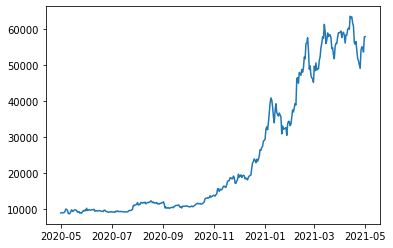

In [17]:
btc = getHistoricalData('BTC')
print(btc.columns)
print(btc.head())
print(btc.shape)
plt.plot(btc['Date'],btc['Close'])
plt.plot()
plt.show()

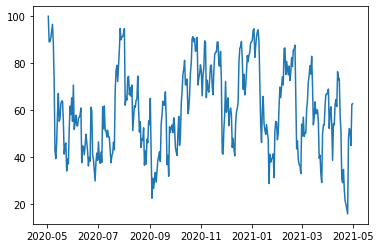

In [18]:
#method for calculating RSI
def getrsi(df,i):
  delta = df['Close'].diff()
  up = delta.clip(lower=0)
  down = -1*delta.clip(upper=0)
  ema_up = up.ewm(com=i-1, adjust=False).mean()
  ema_down = down.ewm(com=i-1, adjust=False).mean()
  rs = ema_up/ema_down

  df['rsi'+str(i)] = 100 - (100/(1 + rs))
  
btc = getHistoricalData('BTC')
getrsi(btc,7)
plt.plot(btc['Date'],btc['rsi7'])


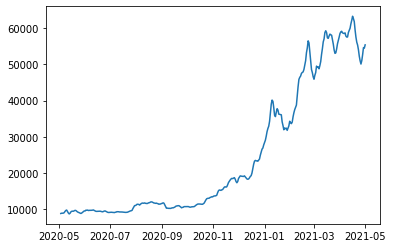

In [19]:
#method for calculating RSI
def getsma(df,i):
  df['sma'+str(i)] = df.iloc[:,1].rolling(window=i).mean()

btc = getHistoricalData('BTC')
getsma(btc,3)
plt.plot(btc['Date'],btc['sma3'])

In [20]:
btc.describe()

,Open,High,Low,Close,Volume,Market Cap,sma3
count,366.000000,366.000000,366.000000,366.000000,3.660000e+02,3.660000e+02,364.000000
mean,24327.807771,25038.951313,23612.018122,24460.846080,4.265800e+10,4.548555e+11,24282.710914
std,18066.440175,18654.983681,17404.618396,18132.193333,2.594540e+10,3.392360e+11,18000.734263
min,8610.386212,8949.897979,8374.322975,8601.796202,1.225260e+10,1.580592e+11,8723.769888
25%,10243.944241,10452.170041,10027.159742,10254.727795,2.463782e+10,1.896467e+11,10295.654810
50%,13548.491766,13823.009163,13189.679277,13602.353912,3.919577e+10,2.520529e+11,13521.464661
75%,37226.717138,38545.697524,36048.511576,37433.157428,5.482160e+10,6.967721e+11,36944.400996
max,63523.754869,64863.098908,62208.964366,63503.457930,3.509679e+11,1.186364e+12,63285.818755


In [74]:
def preprocessData(df,scale=True,train_samples = 270,n_steps=14,lookup_step = 7):
  df=df.dropna()
  getsma(df,5)
  getsma(df,10)
  getrsi(df,14)
  getrsi(df,7)
  feature_columns =['Open','High','Low','Close','Volume','Market Cap','sma5','sma10','rsi7','rsi14']
  #feature_columns =['Open','High','Low','Close','Volume','Market Cap','sma5','sma10']
  result = {}
  result['df'] = df.copy()
  if scale:
    column_scaler = {}
        # scale the data (prices) from 0 to 1
    for column in feature_columns:
      scaler = preprocessing.MinMaxScaler()
      df[column] = scaler.fit_transform(np.expand_dims(df[column].values, axis=1))
      column_scaler[column] = scaler
        # add the MinMaxScaler instances to the result returned
    result["column_scaler"] = column_scaler

  df['Prediction'] = df['Close'].shift(-lookup_step)
  last_sequence = np.array(df[feature_columns].tail(lookup_step))
  df.dropna(inplace=True)
  sequence_data = []
  sequences = deque(maxlen=n_steps)
  for entry, target in zip(df[feature_columns].values, df['Prediction'].values):
      sequences.append(entry)
      if len(sequences) == n_steps:
            sequence_data.append([np.array(sequences), target])
  last_sequence = list([s[:len(feature_columns)] for s in sequences]) + list(last_sequence)
  last_sequence = np.array(last_sequence).astype(np.float32)
  # add to result
  result['last_sequence'] = last_sequence
  X, y = [], []
  for seq, target in sequence_data:
    # i=0
    # if i!=0 :
    #   X.append(seq)
    # i+=1
    X.append(seq)
    y.append(target)
  
    # convert to numpy arrays
  X = np.asarray(X).astype(np.float32)
  y = np.asarray(y).astype(np.float32)
  y = np.expand_dims(y,-1)
  result["X_train"] = np.asarray(X[:train_samples]).astype(np.float32)
  result["y_train"] = np.asarray(y[:train_samples]).astype(np.float32)
  result["X_test"]  = np.asarray(X[train_samples:]).astype(np.float32)
  result["y_test"]  = np.asarray(y[train_samples:]).astype(np.float32)
  return result

(5, 10)


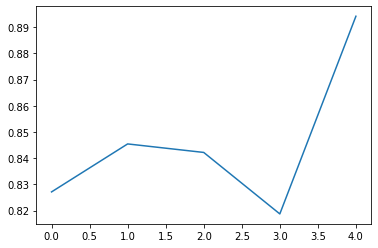

In [75]:
btc = getHistoricalData('BTC')
result = preprocessData(btc,lookup_step=1,n_steps=4)
print(result["last_sequence"].shape)
plt.plot(result["last_sequence"][:,0])

(270, 14, 10)
(270, 1)
(15, 10)


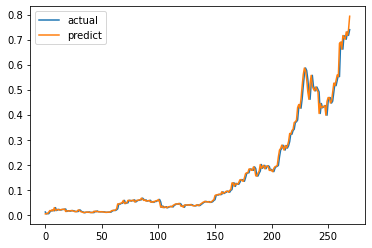

In [78]:
btc = getHistoricalData('BTC')
result = preprocessData(btc,lookup_step=1,n_steps=14)
print(result["X_train"].shape)
print(result["y_train"].shape)
print(result["last_sequence"].shape)
plt.plot(result["X_train"][:,-1,3], label="actual")
plt.plot(result["y_train"][:,0],label ="predict")
plt.legend()
plt.show()

In [114]:
lookup_step = 4
n_step=str(7)
n_steps=7
btc = getHistoricalData('BTC')
getsma(btc,5)
getsma(btc,10)
getrsi(btc,7)
getrsi(btc,14)
btc['Prediction'+str(lookup_step)] = btc['Close'].shift(-lookup_step)
btc= btc.dropna()
for i in range(1,n_steps+1):
   btc["Open-"+str(i)] = btc['Open'].shift(i)
   btc["High-"+str(i)] = btc['Low'].shift(i)
   btc["Close-"+str(i)] = btc['Close'].shift(i)
   btc["Low-"+str(i)] = btc['Low'].shift(i)
   btc["Volume-"+str(i)] = btc['Volume'].shift(i)
   btc["MC-"+str(i)] = btc['Market Cap'].shift(i)
   btc["sma5-"+str(i)] = btc['sma5'].shift(i)
   btc["sma10-"+str(i)] = btc['sma10'].shift(i)
   btc["rsi7-"+str(i)] = btc['rsi7'].shift(i)
   btc["rsi14-"+str(i)] = btc['rsi14'].shift(i)
btc= btc.dropna()


In [115]:
btc

,Date,Open,High,Low,Close,Volume,Market Cap,sma5,sma10,rsi7,rsi14,Prediction4,Open-1,High-1,Close-1,Low-1,Volume-1,MC-1,sma5-1,sma10-1,rsi7-1,rsi14-1,Open-2,High-2,Close-2,Low-2,Volume-2,MC-2,sma5-2,sma10-2,rsi7-2,rsi14-2,Open-3,High-3,Close-3,Low-3,Volume-3,MC-3,sma5-3,sma10-3,...,Open-4,High-4,Close-4,Low-4,Volume-4,MC-4,sma5-4,sma10-4,rsi7-4,rsi14-4,Open-5,High-5,Close-5,Low-5,Volume-5,MC-5,sma5-5,sma10-5,rsi7-5,rsi14-5,Open-6,High-6,Close-6,Low-6,Volume-6,MC-6,sma5-6,sma10-6,rsi7-6,rsi14-6,Open-7,High-7,Close-7,Low-7,Volume-7,MC-7,sma5-7,sma10-7,rsi7-7,rsi14-7
349,2020-05-17,9374.929987,9823.002288,9349.546071,9670.739371,4.008425e+10,1.777454e+11,9303.835417,9325.333703,62.736873,65.759483,9081.762023,9333.239873,9260.694163,9377.014026,9260.694163,3.616477e+10,1.723410e+11,9150.926662,9314.030211,56.410398,62.548275,9734.290775,9261.398000,9328.197226,9261.398000,4.815880e+10,1.714363e+11,9035.385816,9281.450349,55.330011,61.998260,9271.328638,9255.034846,9733.721471,9255.034846,5.642691e+10,1.788816e+11,9006.761507,9199.304487,...,8805.387813,8805.387813,9269.987706,8805.387813,4.555814e+10,1.703527e+11,9120.677056,9161.746111,58.462117,65.197657,8610.386212,8569.643988,8804.477811,8569.643988,4.214272e+10,1.617916e+11,9346.831990,9179.568745,46.139083,59.233615,8755.535639,8374.322975,8601.796202,8374.322975,5.711986e+10,1.580592e+11,9477.133759,9205.435885,39.433363,56.198900,9591.169231,8395.107451,8756.431142,8395.107451,6.332528e+10,1.608848e+11,9527.514882,9197.160513,42.928497,59.327731
348,2020-05-18,9675.694980,9906.030203,9570.358985,9726.574815,4.182714e+10,1.787795e+11,9477.896851,9299.286953,63.898896,66.350137,9182.577518,9374.929987,9349.546071,9670.739371,9349.546071,4.008425e+10,1.777454e+11,9303.835417,9325.333703,62.736873,65.759483,9333.239873,9260.694163,9377.014026,9260.694163,3.616477e+10,1.723410e+11,9150.926662,9314.030211,56.410398,62.548275,9734.290775,9261.398000,9328.197226,9261.398000,4.815880e+10,1.714363e+11,9035.385816,9281.450349,...,9271.328638,9255.034846,9733.721471,9255.034846,5.642691e+10,1.788816e+11,9006.761507,9199.304487,67.187268,69.918903,8805.387813,8805.387813,9269.987706,8805.387813,4.555814e+10,1.703527e+11,9120.677056,9161.746111,58.462117,65.197657,8610.386212,8569.643988,8804.477811,8569.643988,4.214272e+10,1.617916e+11,9346.831990,9179.568745,46.139083,59.233615,8755.535639,8374.322975,8601.796202,8374.322975,5.711986e+10,1.580592e+11,9477.133759,9205.435885,39.433363,56.198900
347,2020-05-19,9727.063604,9836.047524,9539.624055,9729.037919,3.925429e+10,1.788316e+11,9569.043844,9287.902675,63.956743,66.377691,9209.287428,9675.694980,9570.358985,9726.574815,9570.358985,4.182714e+10,1.787795e+11,9477.896851,9299.286953,63.898896,66.350137,9374.929987,9349.546071,9670.739371,9349.546071,4.008425e+10,1.777454e+11,9303.835417,9325.333703,62.736873,65.759483,9333.239873,9260.694163,9377.014026,9260.694163,3.616477e+10,1.723410e+11,9150.926662,9314.030211,...,9734.290775,9261.398000,9328.197226,9261.398000,4.815880e+10,1.714363e+11,9035.385816,9281.450349,55.330011,61.998260,9271.328638,9255.034846,9733.721471,9255.034846,5.642691e+10,1.788816e+11,9006.761507,9199.304487,67.187268,69.918903,8805.387813,8805.387813,9269.987706,8805.387813,4.555814e+10,1.703527e+11,9120.677056,9161.746111,58.462117,65.197657,8610.386212,8569.643988,8804.477811,8569.643988,4.214272e+10,1.617916e+11,9346.831990,9179.568745,46.139083,59.233615
346,2020-05-20,9725.329365,9804.793888,9447.201541,9522.981157,3.654624e+10,1.750510e+11,9567.251562,9301.318689,55.307235,61.817385,8790.368001,9727.063604,9539.624055,9729.037919,9539.624055,3.925429e+10,1.788316e+11,9569.043844,9287.902675,63.956743,66.377691,9675.694980,9570.358985,9726.574815,9570.358985,4.182714e+10,1.787795e+11,9477.896851,9299.286953,63.898896,66.350137,9374.929987,9349.546071,9670.739371,9349.546071,4.008425e+10,1.777454e+11,9303.835417,9325.333703,...,9333.239873,9260.694163,9377.014026,9260.694163,3.616477e+10,1.723410e+11,9150.92

In [104]:
btc.iloc[:-7,:1]


,Date
356,2020-05-10
355,2020-05-11
354,2020-05-12
353,2020-05-13
352,2020-05-14
...,...
15,2021-04-16
14,2021-04-17
13,2021-04-18
12,2021-04-19


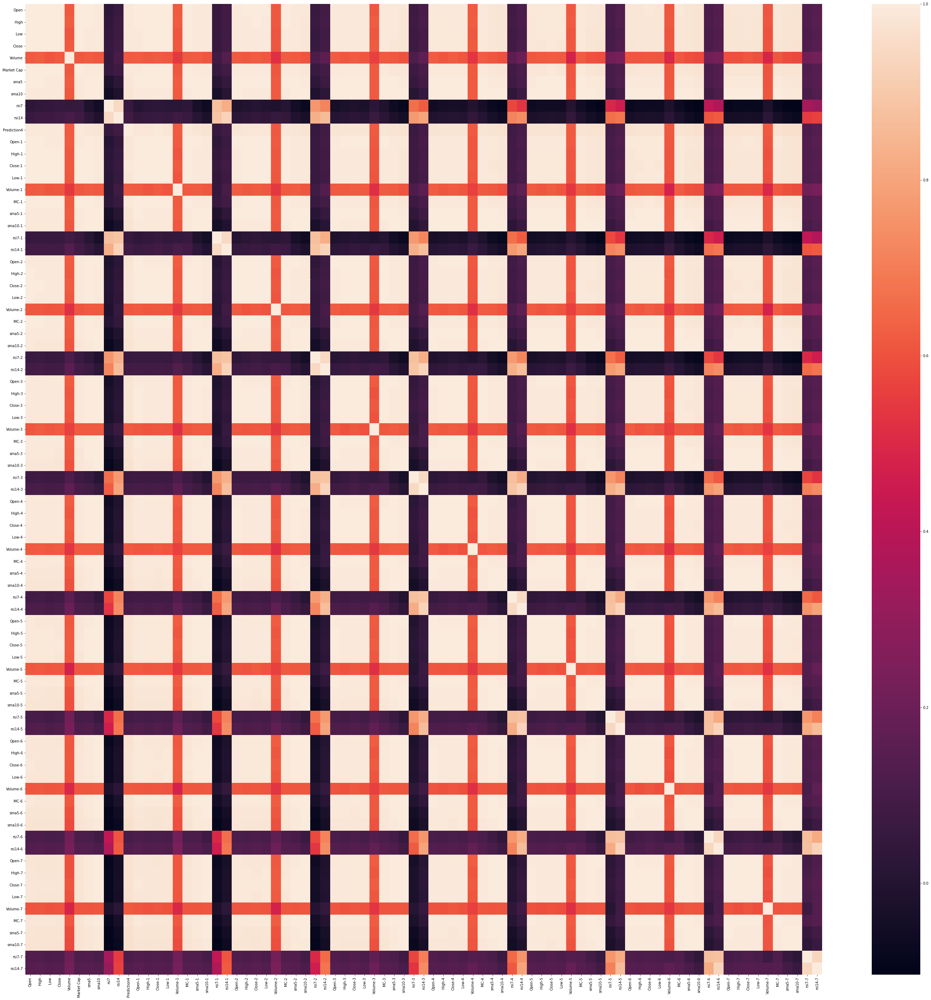

In [119]:
# correlation
import seaborn as sns
fig = plt.figure( figsize = (50,50))
corr = btc.corr()
sns.heatmap(corr,xticklabels=True, yticklabels=True,)



In [120]:
correlated_features = set()
correlation_matrix = btc.corr()
for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.8:
            colname = correlation_matrix.columns[i]
            correlated_features.add(colname)

print(correlated_features)

{'MC-5', 'rsi7-3', 'rsi7-4', 'High-5', 'rsi7-6', 'Close-2', 'rsi7-1', 'Open-3', 'Prediction4', 'Low-3', 'Open-4', 'Close-5', 'Low-6', 'High', 'sma10-3', 'rsi7-7', 'Low-2', 'sma5-2', 'Close-6', 'sma10', 'MC-3', 'rsi14-6', 'Close-3', 'Open-2', 'High-2', 'sma10-2', 'High-4', 'Low-1', 'rsi14-3', 'sma10-1', 'MC-2', 'rsi14-1', 'sma10-7', 'MC-6', 'Market Cap', 'Open-1', 'High-1', 'Open-5', 'rsi14-5', 'High-7', 'High-6', 'sma10-5', 'rsi7-5', 'rsi14', 'sma5-4', 'Open-7', 'MC-1', 'sma5', 'Close', 'rsi7-2', 'sma5-7', 'Close-7', 'Low-4', 'Low-7', 'High-3', 'Low-5', 'Close-1', 'sma10-4', 'rsi14-4', 'MC-4', 'rsi14-2', 'rsi14-7', 'sma5-6', 'sma10-6', 'sma5-1', 'Close-4', 'Low', 'Open-6', 'MC-7', 'sma5-3', 'sma5-5'}


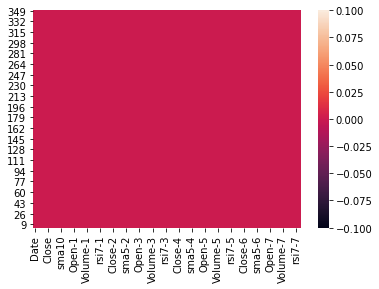

In [121]:
btc=btc.dropna()
sns.heatmap(btc.isnull())

In [ ]:
btc = getHistoricalData('BTC')
result = preprocessData(btc)
plt.plot()

In [123]:
token = 'BNB'

In [124]:
data = getHistoricalData(token)
data1 = preprocessData(data,scale=False)
data2 = preprocessData(data)
print(data2['X_test'])
print(data2['y_test'])

[[[0.06112002 0.06638411 0.06250781 ... 0.05622176 0.85018307 0.7142677 ]
  [0.06732502 0.08457309 0.06989145 ... 0.05892415 0.9255069  0.81518614]
  [0.08682591 0.09564947 0.08027191 ... 0.06383708 0.93995035 0.8401221 ]
  ...
  [0.1994831  0.19753458 0.17662898 ... 0.16979375 0.72368157 0.73856956]
  [0.18871994 0.18805274 0.18845718 ... 0.18144336 0.72650295 0.7401375 ]
  [0.1892803  0.2548431  0.1889521  ... 0.19221327 0.8516501  0.8216926 ]]

 [[0.06732502 0.08457309 0.06989145 ... 0.05892415 0.9255069  0.81518614]
  [0.08682591 0.09564947 0.08027191 ... 0.06383708 0.93995035 0.8401221 ]
  [0.09508078 0.0943893  0.08410726 ... 0.0698387  0.7720425  0.7226089 ]
  ...
  [0.18871994 0.18805274 0.18845718 ... 0.18144336 0.72650295 0.7401375 ]
  [0.1892803  0.2548431  0.1889521  ... 0.19221327 0.8516501  0.8216926 ]
  [0.24680693 0.29370102 0.24955799 ... 0.21037771 0.8999099  0.86339337]]

 [[0.08682591 0.09564947 0.08027191 ... 0.06383708 0.93995035 0.8401221 ]
  [0.09508078 0.094389

In [125]:

def create_model(sequence_length=50, n_features=6, units=256, cell=LSTM, n_layers=2, dropout=0.2,
                loss="mean_absolute_error", optimizer="Adam", bidirectional=False):
    model = Sequential()
    for i in range(n_layers):
        if i == 0:
            # first layer
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=True), batch_input_shape=(None, sequence_length, n_features)))
            else:
                model.add(cell(units, return_sequences=True, batch_input_shape=(None, sequence_length, n_features)))
        elif i == n_layers - 1:
            # last layer
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=False)))
            else:
                model.add(cell(units, return_sequences=False))
        else:
            # hidden layers
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=True)))
            else:
                model.add(cell(units, return_sequences=True))
        # add dropout after each layer
        model.add(Dropout(dropout))
    model.add(Dense(1, activation="linear"))
    model.compile(loss=loss, metrics=["mean_absolute_error"], optimizer=optimizer)
    return model

In [126]:


def create_model2(sequence_length=50, n_features=6, units=256, cell=LSTM, n_layers=2, dropout=0.2,
                loss="mean_absolute_error", optimizer="Adam", bidirectional=False):
    model = Sequential()
    for i in range(4):
        if i == 0:
            # first layer
            units=16
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=True), batch_input_shape=(None, sequence_length, n_features)))
            else:
                model.add(cell(units, return_sequences=True, batch_input_shape=(None, sequence_length, n_features)))
        elif i == 1:
            # second layer
            units=32
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=True)))
            else:
                model.add(cell(units, return_sequences=True))
        elif i==2:
            # third layer
            units=64
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=True)))
            else:
                model.add(cell(units, return_sequences=True))
        
        else:
            # last layers
            units=128
            if bidirectional:
                model.add(Bidirectional(cell(units, return_sequences=False)))
            else:
                model.add(cell(units, return_sequences=False))
        
        # add dropout after each layer
        model.add(Dropout(dropout))
    model.add(Dense(1, activation="linear"))
    model.compile(loss=loss, metrics=["mean_absolute_error"], optimizer=optimizer)
    return model

In [127]:
from google.colab import drive
drive_path = '/content/drive'
drive.mount(drive_path)

Mounted at /content/drive


In [128]:
import os
project_path = os.path.join(drive_path, 'MyDrive','Project')
if not os.path.isdir(project_path):
  os.makedirs(project_path,exist_ok=True)
result_path = os.path.join(project_path,'results')
if not os.path.isdir(result_path):
    os.makedirs(result_path,exist_ok=True)
logs_path = os.path.join(project_path,'logs')
if not os.path.isdir(logs_path):
    os.makedirs(logs_path,exist_ok=True)

data_path = os.path.join(project_path,'data')
if not os.path.isdir(data_path):
    os.makedirs(data_path,exist_ok=True)




In [130]:
import time
sequence_length=14
n_steps=14
n_features=10
units=64
cell=LSTM
n_layers=5
dropout=0.2
loss="mean_squared_error"
optimizer="Adam"
bidirectional=True
model = create_model(sequence_length, n_features, units, cell, n_layers, dropout,
                loss, optimizer, bidirectional)
ticker = "BTC"
date_now = time.strftime("%Y-%m-%d-%H:%M:%S")
# some tensorflow callbacks
model_name = f"{date_now}_{ticker}-\
{loss}-{optimizer}-{cell}-seq-{n_steps}-step-{lookup_step}-layers-{n_layers}-units-{units}"
checkpointer = ModelCheckpoint(os.path.join(result_path, model_name + ".h5"), save_weights_only=True, save_best_only=True, verbose=1)
tensorboard = TensorBoard(log_dir=os.path.join(logs_path, model_name))
earlystopper = EarlyStopping(monitor='val_loss', mode='min',patience=5, verbose=1)

# train the model and save the weights whenever we see 
# a new optimal model using ModelCheckpoint
data = getHistoricalData2(ticker)
data = preprocessData(data,scale=True,n_steps=n_steps)
history = model.fit(data["X_train"], data["y_train"],
                    batch_size=45,
                    epochs=200,
                    validation_data=(data["X_test"], data["y_test"]),
                    callbacks=[checkpointer, tensorboard,earlystopper],
                    verbose=1)

Epoch 1/200
6/6 [==============================] - 18s 970ms/step - loss: 0.0297 - mean_absolute_error: 0.1223 - val_loss: 0.0046 - val_mean_absolute_error: 0.0541

Epoch 00001: val_loss improved from inf to 0.00457, saving model to /content/drive/MyDrive/Project/results/2021-08-14-11:07:57_BTC-mean_squared_error-Adam-<class 'tensorflow.python.keras.layers.recurrent_v2.LSTM'>-seq-14-step-4-layers-5-units-64.h5
Epoch 2/200
6/6 [==============================] - 1s 100ms/step - loss: 0.0082 - mean_absolute_error: 0.0652 - val_loss: 0.0049 - val_mean_absolute_error: 0.0595

Epoch 00002: val_loss did not improve from 0.00457
Epoch 3/200
6/6 [==============================] - 1s 99ms/step - loss: 0.0067 - mean_absolute_error: 0.0586 - val_loss: 0.0070 - val_mean_absolute_error: 0.0713

Epoch 00003: val_loss did not improve from 0.00457
Epoch 4/200
6/6 [==============================] - 1s 96ms/step - loss: 0.0050 - mean_absolute_error: 0.0470 - val_loss: 0.0101 - val_mean_absolute_error: 0.

In [131]:
print(data['y_train'].shape)
print(data['y_test'].shape)
print(data['X_train'].shape)


(270, 1)
(74, 1)
(270, 14, 10)


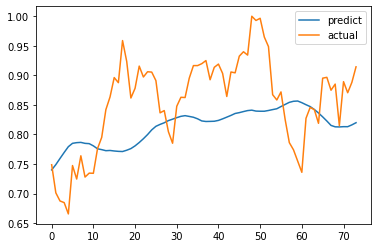

In [132]:
prediction = model.predict(data['X_test'])
plt.plot(prediction,label='predict')
data['y_train']
plt.plot(data['y_test'],label='actual')
plt.legend()


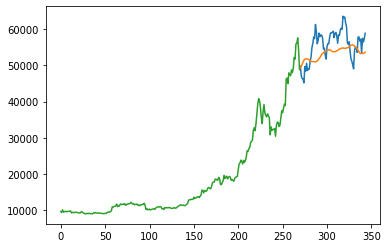

In [133]:
y_test=data['y_test']
y_train=data['y_train']
y_pred = model.predict(data['X_test'])
y_test = np.squeeze(data["column_scaler"]["Close"].inverse_transform(y_test))
y_pred = np.squeeze(data["column_scaler"]["Close"].inverse_transform(y_pred))
y_train = np.squeeze(data["column_scaler"]["Close"].inverse_transform(y_train))
x_data = range(344)
plt.plot(x_data[270:],y_test)
plt.plot(x_data[270:],y_pred)
plt.plot(x_data[:270],y_train[-270:])

In [142]:
n_steps=14
lookup_step = 7
def preprocessDataforPrediction(df,scale=True,n_steps=14,lookup_step=7):
  getsma(df,5)
  getsma(df,10)
  getrsi(df,14)
  getrsi(df,7)
  feature_columns =['Open','High','Low','Close','Volume','Market Cap','sma5','sma10','rsi7','rsi14']
  #feature_columns =['Open','High','Low','Close','Volume','Market Cap','sma5','sma10']
  result = {}
  result['df'] = df.copy()
  if scale:
    column_scaler = {}
        # scale the data (prices) from 0 to 1
    for column in feature_columns:
      scaler = preprocessing.MinMaxScaler()
      df[column] = scaler.fit_transform(np.expand_dims(df[column].values, axis=1))
      column_scaler[column] = scaler
        # add the MinMaxScaler instances to the result returned
    result["column_scaler"] = column_scaler

  
  df.dropna(inplace=True)
  sequence_data = []
  sequences = deque(maxlen=n_steps)
  for entry in df[feature_columns].values:
      sequences.append(entry)
      if len(sequences) == n_steps:
            sequence_data.append(np.array(sequences))

  # add to result

  X = sequence_data

  
    # convert to numpy arrays
  X = np.asarray(X).astype(np.float32)
  X = np.asarray(X[X.shape[0]-lookup_step:]).astype(np.float32)

  return X, result["column_scaler"]



(7, 14, 10)
[[0.81524926]
 [0.8128553 ]
 [0.81268233]
 [0.8131308 ]
 [0.8130843 ]
 [0.8161548 ]
 [0.8198243 ]]
[53360.336 53228.902 53219.406 53244.027 53241.477 53410.05  53611.51 ]
[56631.07741255 57200.29122289 53333.53775274 57424.00594813
 56396.51416376 57356.40187692 58803.77580865]


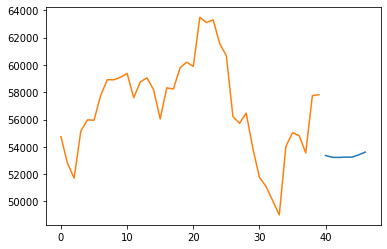

In [143]:
#prediction for 2-8 may
def predictFuture(token='BTC',model=model):
    data = getHistoricalData(token)
    X,scaler = preprocessDataforPrediction(data)
    print(X.shape)
    prediction = model.predict(X)
    return prediction,data,scaler
    
token ='BTC'
pred,a,sc = predictFuture(token)
data2 = getHistoricalData2(token)
x_data = range(47)
pred = np.squeeze(data["column_scaler"]["Close"].inverse_transform(pred))
a = np.squeeze(sc["Close"].inverse_transform(np.expand_dims(a['Close'].values,axis=1)))
plt.plot(x_data[40:],pred)
plt.plot(x_data[0:40],a[-40:])
#plt.plot(x_data[:],data2['Close'].values[data2.shape[0]-47:])
print(pred)
print(data2['Close'].values[data2.shape[0]-7:data2.shape[0]])

In [137]:
data['column_scaler']

{'Close': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'High': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'Low': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'Market Cap': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'Open': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'Volume': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'rsi14': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'rsi7': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'sma10': MinMaxScaler(copy=True, feature_range=(0, 1)),
 'sma5': MinMaxScaler(copy=True, feature_range=(0, 1))}

In [ ]:
model = create_model(sequence_length, n_features, units, cell, n_layers, dropout,
                loss, optimizer, bidirectional)
[print(i.shape, i.dtype) for i in model.inputs]
print('---------------')
[print(o.shape, o.dtype) for o in model.outputs]
print('---------------')
[print(l.name, l.input_shape, l.dtype) for l in model.layers]

(None, 50, 6) <dtype: 'float32'>
---------------
(None, 1) <dtype: 'float32'>
---------------
lstm_54 (None, 50, 6) float32
dropout_54 (None, 50, 256) float32
lstm_55 (None, 50, 256) float32
dropout_55 (None, 256) float32
dense_27 (None, 256) float32


[None, None, None, None, None]

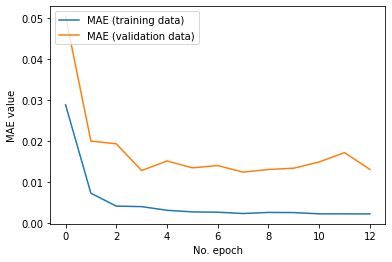

In [ ]:
plt.plot(history.history['loss'], label='MAE (training data)')
plt.plot(history.history['val_loss'], label='MAE (validation data)')
plt.ylabel('MAE value')
plt.xlabel('No. epoch')
plt.legend(loc="upper left")
plt.show()

In [ ]:
!pip uninstall -y tensorboard tb-nightly 

Uninstalling tensorboard-2.4.1:
  Successfully uninstalled tensorboard-2.4.1


In [ ]:
pip install tb-nightly

     |████████████████████████████████| 5.9MB 3.9MB/s 
     |████████████████████████████████| 4.9MB 44.0MB/s 


In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/Project/logs

Reusing TensorBoard on port 6006 (pid 1243), started 0:02:20 ago. (Use '!kill 1243' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!kill 1147

In [ ]:
%tensorboard --logdir logs_path

ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
[2021-05-05T17:26:08Z ERROR rustboard_core::disk_logdir] While walking log directory: IO error for operation on logs_path: No such file or directory (os error 2)

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Traceback (most recent call last):
  File "/usr/local/bin/tensorboard", line 8, in <module>
    sys.exit(run_main())
  File "/usr/local/lib/python3.7/dist-packages/tensorboard/main.py", line 46, in run_main
    app.run(tensorboard.main, flags_parser=tensorboard.configure)
  File "/usr/local/lib/python3.7/dist-packages/absl/app.py", line 303, in run
    _run_main(main, args)
  File "/usr/local/lib/python3.7/dist-packages/absl/app.py", line 251, in _run_main
    sys.exit(main(argv))
  File "/usr/local/lib/python3.7/dist-packages/tensorboard/program.py", line 276, in 